In [56]:
using LinearAlgebra  #####Son las paqueterias que uso, para instalar una paqueteria basta colocar Pkg.add("Nombre_de_la_paqueteria")
using Plots
using SpecialFunctions: gamma
using Random, Distributions
using Alert

In [57]:
function OUH(x0::Float64,γ::Float64,t::AbstractArray,Δt::Float64,η::Float64,cte::Float64=0.0) #Proceso de Ornstein–Uhlenbeck
    x=Vector{Float64}(undef, length(t)) #Definimos un vector lleno de basura para luego sobre escribir en el 
    x[1]=x0    #La primera entrada es la condicion inicial del Proceso de Ornstein–Uhlenbeck
    
    for i=1:length(t)                 #Usamos un for para poder hacer el proceso
        x0=x0-γ*Δt*(x0-cte)+(2*η*sqrt(Δt)*randn()) # Es el proceso de Ornstein–Uhlenbeck que depende del paso anterior 
        @inbounds x[1+i]=x0                 #@inbounds ignora si la lista tiene el tamaño adecuado y sobreescribimos en la lista basura
    end
    return x                          # Devolvemos la caminata de Ornstein–Uhlenbeck
end

OUH (generic function with 2 methods)

In [58]:
function eigen2(n::Int64,K::Array{Float64,1},Δt::Float64) #Obtenemos los eigenvalores y eigenvectores 
    R=diagm(0 =>ones(2))                                #Hacemos una matriz llena de unos en la diagonal de dimension 2
    for i=1:n                                           #Hacemos un for donde n es la cantidad de pasos de t, pasos de tiempo
       R=(diagm(0 => ones(2))+diagm(1 => [K[i]]*Δt,-1 => -[K[i]]*Δt)+(0.5*diagm(1 => [K[i]]*Δt,-1 => -[K[i]]*Δt)^2))*R #Hacemos los pasos de multiplicar la matriz por la matriz anterior 
    end
    eigen(R)#Obtenemos el eigenvalor y eigenvector
end

function eigen2(n::Int64,K::Array{Float64,1},T::Array{Float64,1},Δt::Float64) 
    R=diagm(0 =>ones(3)) #Hacemos una matriz llena de unos en la diagonal de dimension 2
    for i=1:n            #Hacemos un for donde n es la cantidad de pasos de t, pasos de tiempo
       R=(diagm(0 => ones(3))+diagm(1 => [K[i],T[i]]*Δt,-1 => -[K[i],T[i]]*Δt)+(0.5*diagm(1 => [K[i],T[i]]*Δt,-1 => -[K[i],T[i]]*Δt)^2))*R #Hacemos los pasos de multiplicar la matriz por la matriz anterior 
    end
    eigen(R) #Obtenemos el eigenvalor y eigenvector
end

eigen2 (generic function with 2 methods)

In [59]:

function Mat(n::Int64,K::Array{Float64,1},T::Array{Float64,1},Δt::Float64) 
    R=diagm(0 =>ones(3))
    for i=1:n
       R=(diagm(0 => ones(3))+diagm(1 => [K[i],T[i]]*Δt,-1 => -[K[i],T[i]]*Δt)+(0.5*diagm(1 => [K[i],T[i]]*Δt,-1 => -[K[i],T[i]]*Δt)^2))*R
    end
    R
end

function Mat(n::Int64,K::Array{Float64,1},Δt::Float64) #Solo muestra las matrices despues de ser multiplicadas
    R=diagm(0 =>ones(2))
    for i=1:n
       R=(diagm(0 => ones(2))+diagm(1 => [K[i]]*Δt,-1 => -[K[i]]*Δt)+(0.5*diagm(1 => [K[i]]*Δt,-1 => -[K[i]]*Δt)^2))*R
    end
    R
end


Mat (generic function with 2 methods)

In [60]:
function Mat1(n::Int64) 
       R=(diagm(0 => ones(3))+diagm(1 => [K[n],T[n]]*Δt,-1 => -[K[n],T[n]]*Δt)+(0.5*diagm(1 => [K[n],T[n]]*Δt,-1 => -[K[n],T[n]]*Δt)^2))
    return R
end


Mat1 (generic function with 1 method)

In [61]:
function Trayectoria(Δt::Float64,t::AbstractArray,k0::Float64,t0::Float64,K::AbstractArray,T::AbstractArray)
    #T=ones(2001)*5
    #K=ones(2001)*5

    #T_v0=(eigen2(2,K,T,Δt).vectors)[:,1]      #Es el vector tangente inicial
    #N_v0=(eigen2(2,K,T,Δt).vectors)[:,2]*im   #Es el vector tangente inicial
    #B_v0=(eigen2(2,K,T,Δt).vectors)[:,3]      #Es el vector tangente inicial
    T_v0=[1.0,0.0,0.0]     #Es el vector tangente inicial
    N_v0=[0.0,1.0,0.0]   #Es el vector tangente inicial
    B_v0=[0.0,0.0,1.0]      #Es el vector tangente inicial
    ##########################################
    T_v=Array{Float64,1}[]       #Lista vacia para todos los vectores tangentes
    N_v=Array{Float64,1}[]       #Lista vacia para todos los vectores tangentes
    B_v=Array{Float64,1}[]       #Lista vacia para todos los vectores tangentes
    for i=1:length(t)                 #For que dura todos los pasos de tiempo
        T_v0=Mat1(i)*T_v0      #Genera todos los vecotres tangentes a partir del inicial
        N_v0=Mat1(i)*N_v0      #Genera todos los vecotres tangentes a partir del inicial
        B_v0=Mat1(i)*B_v0      #Genera todos los vecotres tangentes a partir del inicial
        push!(T_v,real(T_v0))    #Coloca los vectores tangentes en una lista
        push!(N_v,real(N_v0))    #Coloca los vectores tangentes en una lista
        push!(B_v,real(B_v0))    #Coloca los vectores tangentes en una lista
    end
    T_v=transpose(hcat(T_v...))     #Transforma T en algo mejor
    N_v=transpose(hcat(N_v...))     #Transforma N en algo mejor
    B_v=transpose(hcat(B_v...))     #Transforma B en algo mejor
    ##########################################
    Tx=T_v[:,1]
    Ty=T_v[:,2]
    Tz=T_v[:,3]
    ##########################################
    rx=Float64[]
    ry=Float64[]
    rz=Float64[]
    r1x=0.0
    r1y=0.0
    r1z=0.0
    for i=1:length(t)
        r1x=Tx[i]*Δt+r1x
        r1y=Ty[i]*Δt+r1y
        r1z=Tz[i]*Δt+r1z
        push!(rx,r1x)
        push!(ry,r1y)
        push!(rz,r1z)
    end
    r=[rx,ry,rz]
    T=[Tx,Ty,Tz]
    N=[N_v[:,1],N_v[:,2],N_v[:,3]]
    B=[B_v[:,1],B_v[:,2],B_v[:,3]]
    return r,T,N,B
end




function Trayectoria(Δt::Float64,t::AbstractArray,k0::Float64,K::AbstractArray)
    #T=ones(2001)*5
    #T_v0=(eigen2(2,K,Δt).vectors)[:,1]      #Es el vector tangente inicial
    #N_v0=(eigen2(2,K,Δt).vectors)[:,2]*im   #Es el vector tangente inicial
    T_v0=[1.0,0.0]     #Es el vector tangente inicial
    N_v0=[0.0,1.0]   #Es el vector tangente inicial
    ##########################################
    T_v=Array{Float64,1}[]       #Lista vacia para todos los vectores tangentes
    N_v=Array{Float64,1}[]       #Lista vacia para todos los vectores tangentes
    for i=1:length(t)                 #For que dura todos los pasos de tiempo
        T_v1=Mat(i,K,Δt)*T_v0      #Genera todos los vecotres tangentes a partir del inicial
        N_v1=Mat(i,K,Δt)*N_v0      #Genera todos los vecotres tangentes a partir del inicial
        push!(T_v,real(T_v1))    #Coloca los vectores tangentes en una lista
        push!(N_v,real(N_v1))    #Coloca los vectores tangentes en una lista
    end
    T_v=transpose(hcat(T_v...))     #Transforma T en algo mejor
    N_v=transpose(hcat(N_v...))     #Transforma N en algo mejor
    ##########################################
    Tx=T_v[:,1]
    Ty=T_v[:,2]
    ##########################################
    rx=Float64[]
    ry=Float64[]
    r1x=0.0
    r1y=0.0
    for i=1:length(t)
        r1x=Tx[i]*Δt+r1x
        r1y=Ty[i]*Δt+r1y
        push!(rx,r1x)
        push!(ry,r1y)
    end
    r=[rx,ry]
    T=[Tx,Ty]
    N=[N_v[:,1],N_v[:,2]]
    return r,T,N
end

Trayectoria (generic function with 2 methods)

In [76]:
k0=0.01
t0=0.01
γK=1.0 #FIJA PARA  Adimensional γK=1
γT=2.0
ηK=1.0
ηT=1.0
Δt=0.001
N=30.0
t=0:Δt:N
K=OUH(k0,γK,t,Δt,ηK,1.0) #FIJA PARA  Adimensional cteK=1
T=OUH(t0,γT,t,Δt,ηT,3.0);

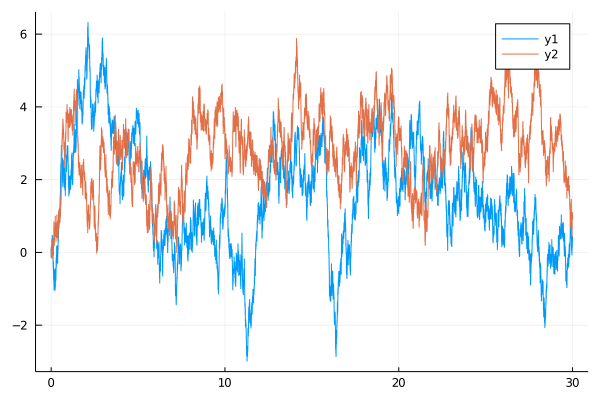

In [77]:
plot(t,K)
plot!(t,T)

In [78]:
@time r,Tm,Nm,Bm=Trayectoria(Δt,t,k0,t0,K,T);

  1.150452 seconds (7.55 M allocations: 309.738 MiB, 27.11% gc time)


In [79]:
l = @layout grid(2,2,heights=[0.5,0.5,0.5,0.5])
P1=plot(r[1],r[2],r[3], legend=false,title="3D",aspect_ratio=:equal,xlabel="x",ylabel="y",zlabel="z")
P2=plot(r[1],r[2],legend=false,title="XY",xlabel="x",ylabel="y")
P3=plot(r[1],r[3],legend=false,title="XZ",xlabel="x",ylabel="z")
P4=plot(r[2],r[3],legend=false,title="YZ",xlabel="y",ylabel="z")
plot(P1,P2,P3,P4,layout=l)
#savefig("./Trayectorias_3D/Trayectoria_3D_gamK=$(γK)_gam=$(γT)_etaK=$(ηK)_etaT=$(ηT).png")

In [80]:
plot(Tm[1],Tm[2],Tm[3], legend=false)
l = @layout grid(2,2,heights=[0.5,0.5,0.5,0.5])
P1=plot(Tm[1],Tm[2],Tm[3], legend=false,title="3D",aspect_ratio=:equal)
P2=plot(Tm[1],Tm[2],legend=false,title="XY",aspect_ratio=:equal)
P3=plot(Tm[1],Tm[3],legend=false,title="XZ",aspect_ratio=:equal)
P4=plot(Tm[2],Tm[3],legend=false,title="YZ",aspect_ratio=:equal)
plot(P1,P2,P3,P4,layout=l)
#savefig("./Trayectorias_3D/Tangente_3D_gamK=$(γK)_gam=$(γT)_etaK=$(ηK)_etaT=$(ηT).png")

In [81]:
l = @layout grid(2,2,heights=[0.5,0.5,0.5,0.5])
P1=plot(Nm[1],Nm[2],Nm[3], legend=false,title="3D",aspect_ratio=:equal)
P2=plot(Nm[1],Nm[2],legend=false,title="XY",aspect_ratio=:equal)
P3=plot(Nm[1],Nm[3],legend=false,title="XZ",aspect_ratio=:equal)
P4=plot(Nm[2],Nm[3],legend=false,title="YZ",aspect_ratio=:equal)
plot(P1,P2,P3,P4,layout=l)
#savefig("./Trayectorias_3D/Normal_3D_gamK=$(γK)_gam=$(γT)_etaK=$(ηK)_etaT=$(ηT).png")

In [82]:
l = @layout grid(2,2,heights=[0.5,0.5,0.5,0.5])
P1=plot(Bm[1],Bm[2],Bm[3], legend=false,title="3D",aspect_ratio=:equal)
P2=plot(Bm[1],Bm[2],legend=false,title="XY",aspect_ratio=:equal)
P3=plot(Bm[1],Bm[3],legend=false,title="XZ",aspect_ratio=:equal)
P4=plot(Bm[2],Bm[3],legend=false,title="YZ",aspect_ratio=:equal)
plot(P1,P2,P3,P4,layout=l)
#savefig("./Trayectorias_3D/Binormal_3D_gamK=$(γK)_gam=$(γT)_etaK=$(ηK)_etaT=$(ηT).png")

In [21]:
alert("TERMINO LAS TRAYECTORIAS 3D");

base64 binary data: IzwgQ0xJWE1MDQo8T2JqcyBWZXJzaW9uPSIxLjEuMC4xIiB4bWxucz0iaHR0cDovL3NjaGVtYXMubWljcm9zb2Z0LmNvbS9wb3dlcnNoZWxsLzIwMDQvMDQiPjxPYmogUz0icHJvZ3Jlc3MiIFJlZklkPSIwIj48VE4gUmVmSWQ9IjAiPjxUPlN5c3RlbS5NYW5hZ2VtZW50LkF1dG9tYXRpb24uUFNDdXN0b21PYmplY3Q8L1Q+PFQ+U3lzdGVtLk9iamVjdDwvVD48L1ROPjxNUz48STY0IE49IlNvdXJjZUlkIj4xPC9JNjQ+PFBSIE49IlJlY29yZCI+PEFWPlByZXBhcmFuZG8gbaJkdWxvcyBwYXJhIGVsIHByaW1lciB1c28uPC9BVj48QUk+MDwvQUk+PE5pbCAvPjxQST4tMTwvUEk+PFBDPi0xPC9QQz48VD5Db21wbGV0ZWQ8L1Q+PFNSPi0xPC9TUj48U0Q+IDwvU0Q+PC9QUj48L01TPjwvT2JqPjwvT2Jqcz4=


In [83]:
plot(t,sqrt.(Tm[1].^2+Tm[2].^2+Tm[3].^2),ylims=(0,2));

In [ ]:
r2,T2m,N2m=Trayectoria(Δt,t,k0,K);

In [ ]:
l = @layout grid(2,2,heights=[0.5,0.5,0.5,0.5])
P1=plot(r2[1],r2[2], legend=false,title="2D",aspect_ratio=:equal)
P2=plot(r2[1],t,legend=false,title="rx vs t",aspect_ratio=:equal)
P3=plot(t,r2[2],legend=false,title="t vs ry",aspect_ratio=:equal)
P4=plot(t,K)
plot(P1,P3,P2,P4,layout=l)
#savefig("./Trayectorias_2D/Trayectoria_2D_gamK=$(γK)_etaK=$(ηK).png")

In [ ]:
l = @layout grid(2,2,heights=[0.5,0.5,0.5,0.5])
P1=plot(T2m[1],T2m[2], legend=false,title="2D",aspect_ratio=:equal)
P2=plot(T2m[1],t,legend=false,title="Tx vs t",aspect_ratio=:equal)
P3=plot(t,T2m[2],legend=false,title="t vs Ty",aspect_ratio=:equal)
P4=plot(t,K)
plot(P1,P3,P2,P4,layout=l)
#savefig("./Trayectorias_2D/Tangente_2D_gamK=$(γK)_etaK=$(ηK).png")

In [ ]:
l = @layout grid(2,2,heights=[0.5,0.5,0.5,0.5])
P1=plot(N2m[1],N2m[2], legend=false,title="2D",aspect_ratio=:equal)
P2=plot(N2m[1],t,legend=false,title="Nx vs t",aspect_ratio=:equal)
P3=plot(t,N2m[2],legend=false,title="t vs Ny",aspect_ratio=:equal)
P4=plot(t,K)
plot(P1,P3,P2,P4,layout=l)
#savefig("./Trayectorias_2D/Normal_2D_gamK=$(γK)_etaK=$(ηK).png")

# Ensamble Teórico

In [25]:
function Espaciamiento_3N(tiradas::Int64,λ_3::AbstractArray)
    Δθ=Float64[]
    for i=1:tiradas
        for j=1:2
            a=(sort(angle.(λ_3)[((i-1)*3)+1:3*i])[j+1]-sort(angle.(λ_3)[((i-1)*3)+1:3*i])[j])
            push!(Δθ,a)
        end
    end
    return Δθ
end
function HarR(n) #Genera Matrices Ortogonales con ayuda de la mdeida de Harr SO(n) Con entradas reales CRE??
    z = (randn(n,n))
    Q,R= qr(z)
    d=Diagonal(R)
    ph = d/abs.(d)
    RR=Q*ph*Q
    return RR
end
function SO(N)
    a=-1
    R=rand(N,N)
    while a<0 
        R=HarR(3)
        a=det(R)
    end
    return R
end


SO (generic function with 1 method)

In [26]:

function MAT(paso)
    A=[]
    M=diagm(0 =>ones(3))
    for i=1:paso
        M=M*SO(3)  #Intentar con HarR y Harr_COE(n) y Harr_CUE(n) y SO(3)
        push!(A,M)
    end
    return A
end

MAT (generic function with 1 method)

In [27]:
length(MAT(length(t)))

8001

In [28]:
length(t)

8001

In [29]:
function Trayectoria_teo(Δt::Float64,t::AbstractArray)
    #T=ones(2001)*5
    #K=ones(2001)*5

    #T_v0=(eigen2(2,K,T,Δt).vectors)[:,1]      #Es el vector tangente inicial
    #N_v0=(eigen2(2,K,T,Δt).vectors)[:,2]*im   #Es el vector tangente inicial
    #B_v0=(eigen2(2,K,T,Δt).vectors)[:,3]      #Es el vector tangente inicial
    T_v0=[1.0,0.0,0.0]     #Es el vector tangente inicial
    N_v0=[0.0,1.0,0.0]   #Es el vector tangente inicial
    B_v0=[0.0,0.0,1.0]      #Es el vector tangente inicial
    ##########################################
    T_v=Array{Float64,1}[]       #Lista vacia para todos los vectores tangentes
    N_v=Array{Float64,1}[]       #Lista vacia para todos los vectores tangentes
    B_v=Array{Float64,1}[]       #Lista vacia para todos los vectores tangentes
    A=MAT(length(t))
    for i=1:length(t) #For que dura todos los pasos de tiempo
        T_v1=A[i]*T_v0      #Genera todos los vecotres tangentes a partir del inicial
        N_v1=A[i]*N_v0      #Genera todos los vecotres tangentes a partir del inicial
        B_v1=A[i]*B_v0      #Genera todos los vecotres tangentes a partir del inicial
        push!(T_v,real(T_v1))    #Coloca los vectores tangentes en una lista
        push!(N_v,real(N_v1))    #Coloca los vectores tangentes en una lista
        push!(B_v,real(B_v1))    #Coloca los vectores tangentes en una lista
    end
    T_v=transpose(hcat(T_v...))     #Transforma T en algo mejor
    N_v=transpose(hcat(N_v...))     #Transforma N en algo mejor
    B_v=transpose(hcat(B_v...))     #Transforma B en algo mejor
    ##########################################
    Tx=T_v[:,1]
    Ty=T_v[:,2]
    Tz=T_v[:,3]
    ##########################################
    rx=Float64[]
    ry=Float64[]
    rz=Float64[]
    r1x=0.0
    r1y=0.0
    r1z=0.0
    for i=1:length(t)
        r1x=Tx[i]*Δt+r1x
        r1y=Ty[i]*Δt+r1y
        r1z=Tz[i]*Δt+r1z
        push!(rx,r1x)
        push!(ry,r1y)
        push!(rz,r1z)
    end
    r=[rx,ry,rz]
    T=[Tx,Ty,Tz]
    N=[N_v[:,1],N_v[:,2],N_v[:,3]]
    B=[B_v[:,1],B_v[:,2],B_v[:,3]]
    return r,T,N,B
end


Trayectoria_teo (generic function with 1 method)

In [30]:
@time r3,T3m,N3m,B3m=Trayectoria_teo(Δt,t);

  0.211362 seconds (1.07 M allocations: 94.949 MiB, 4.64% gc time)


In [28]:
l = @layout grid(2,2,heights=[0.5,0.5,0.5,0.5])
P1=plot(r3[1],r3[2],r3[3], legend=false,title="3D",aspect_ratio=:equal)
P2=plot(r3[1],r3[2],legend=false,title="XY")
P3=plot(r3[1],r3[3],legend=false,title="XZ")
P4=plot(r3[2],r3[3],legend=false,title="YZ")
plot(P1,P2,P3,P4,layout=l)

UndefVarError: UndefVarError: r3 not defined

In [32]:
plot(T3m[1],T3m[2],T3m[3], legend=false)
l = @layout grid(2,2,heights=[0.5,0.5,0.5,0.5])
P1=scatter(T3m[1],T3m[2],T3m[3], legend=false,title="3D",aspect_ratio=:equal,markersize = 0.05)
P2=scatter(T3m[1],T3m[2],legend=false,title="XY",aspect_ratio=:equal,markersize = 0.05)
P3=scatter(T3m[1],T3m[3],legend=false,title="XZ",aspect_ratio=:equal,markersize = 0.05)
P4=scatter(T3m[2],T3m[3],legend=false,title="YZ",aspect_ratio=:equal,markersize = 0.05)
plot(P1,P2,P3,P4,layout=l)

In [33]:
l = @layout grid(2,2,heights=[0.5,0.5,0.5,0.5])
P1=scatter(N3m[1],N3m[2],N3m[3], legend=false,title="3D",aspect_ratio=:equal,markersize = 0.5)
P2=scatter(N3m[1],N3m[2],legend=false,title="XY",aspect_ratio=:equal,markersize = 0.5)
P3=scatter(N3m[1],N3m[3],legend=false,title="XZ",aspect_ratio=:equal,markersize = 0.5)
P4=scatter(N3m[2],N3m[3],legend=false,title="YZ",aspect_ratio=:equal,markersize = 0.5)
plot(P1,P2,P3,P4,layout=l)

In [34]:
l = @layout grid(2,2,heights=[0.5,0.5,0.5,0.5])
P1=scatter(B3m[1],B3m[2],B3m[3], legend=false,title="3D",aspect_ratio=:equal,markersize = 0.5)
P2=scatter(B3m[1],B3m[2],legend=false,title="XY",aspect_ratio=:equal,markersize = 0.5)
P3=scatter(B3m[1],B3m[3],legend=false,title="XZ",aspect_ratio=:equal,markersize = 0.5)
P4=scatter(B3m[2],B3m[3],legend=false,title="YZ",aspect_ratio=:equal,markersize = 0.5)
plot(P1,P2,P3,P4,layout=l)

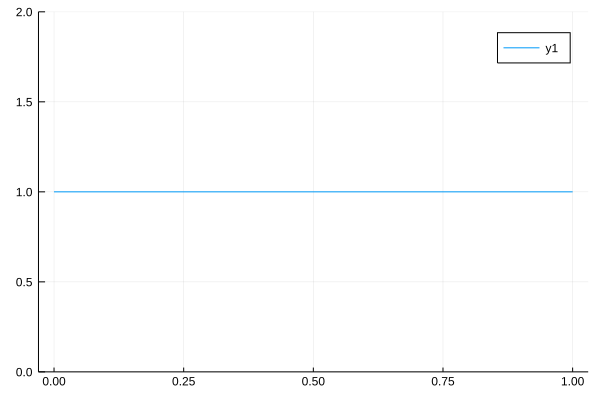

In [81]:
plot(t,sqrt.(T3m[1].^2+T3m[2].^2+T3m[3].^2),ylims=(0,2))

In [18]:
K=OUH(k0,γ,t,Δt,Dt,0.01);
T=OUH(t0,γ,t,Δt,Dt,0.01)
(eigen2(2,K,T,Δt).vectors)[:,1]

3-element Array{Complex{Float64},1}:
 -3.534936670393507e-7 + 0.6323923117699339im
    0.7071067811861063 - 0.0im               
 -7.066341937006504e-7 - 0.3163541749594565im

In [19]:
angle.(eigvals(Mat(256,K,T,Δt)))

3-element Array{Float64,1}:
 -2.9799873831484254
  2.9799873831484254
  0.0               

In [20]:
length(t)

15001

In [264]:
OUH(k0,γ,t,Δt,Dt,0.01)

UndefVarError: UndefVarError: γ not defined

In [22]:
Δt=0.001
K=2
T=4
(diagm(0 => ones(3))+diagm(1 => [K,T]*Δt,-1 => -[K,T]*Δt)+(0.5*diagm(1 => [K,T]*Δt,-1 => -[K,T]*Δt)^2))

3×3 Array{Float64,2}:
  0.999998   0.002    4.0e-6  
 -0.002      0.99999  0.004   
  4.0e-6    -0.004    0.999992

In [423]:
Mat(15001,K,T,Δt)*transpose(Mat(15001,K,T,Δt))

3×3 Array{Float64,2}:
  1.0           1.02538e-10  -9.94604e-10
  1.02538e-10   1.0          -1.32514e-9 
 -9.94604e-10  -1.32514e-9    1.0        

In [432]:
det(Mat(600,K,T,Δt))

1.000000000051084

In [424]:
length(t)

15001

In [2]:
function OUH(x0::Float64,γ::Float64,t::AbstractArray,Δt::Float64,Dt::Float64,cte::Float64=0.0) #Proceso de Ornstein–Uhlenbeck
    x=Vector{Float64}(undef, length(t)) #Definimos un vector lleno de basura para luego sobre escribir en el 
    x[1]=x0    #La primera entrada es la condicion inicial del Proceso de Ornstein–Uhlenbeck
    
    for i=1:length(t)                 #Usamos un for para poder hacer el proceso
        x0=x0-γ*Δt*(x0-cte)+(sqrt(2*Dt*Δt)*randn()) # Es el proceso de Ornstein–Uhlenbeck que depende del paso anterior 
        @inbounds x[1+i]=x0                 #@inbounds ignora si la lista tiene el tamaño adecuado y sobreescribimos en la lista basura
    end
    return x                          # Devolvemos la caminata de Ornstein–Uhlenbeck
end

OUH (generic function with 2 methods)

In [31]:
k0=0.0
t0=0.0
γK=1.0e-2
γT=1.0
DtK=1.0
DtT=1.0
Δt=0.005
N=1000.0
t=0:Δt:N
K=OUH(k0,γK,t,Δt,DtK,0.0)
T=OUH(t0,γT,t,Δt,DtT,100.0);

In [32]:
plot(t,K)
plot!(t,T)

In [13]:
K=OUH(k0,γK,t,Δt,ηK,0.0)
T=OUH(t0,γT,t,Δt,ηT,0.0);

In [43]:
Mat(length(t),K,T,Δt)

3×3 Array{Float64,2}:
  0.532514   0.8135     -0.233767
  0.708482  -0.579509   -0.402769
 -0.463122   0.0488606  -0.884947

In [25]:
length(t)

50001

In [44]:
Mat(length(t),K,T,Δt)*transpose(Mat(length(t),K,T,Δt))

3×3 Array{Float64,2}:
  1.0          -6.88006e-10  -1.46338e-11
 -6.88006e-10   1.0           2.81161e-9 
 -1.46338e-11   2.81161e-9    1.0        

In [45]:
Mat(length(t),K,T,Δt)

3×3 Array{Float64,2}:
  0.532514   0.8135     -0.233767
  0.708482  -0.579509   -0.402769
 -0.463122   0.0488606  -0.884947

In [103]:
eigvals(Mat(8,K,T,Δt))

3-element Array{Complex{Float64},1}:
 0.9994308421645217 - 0.033734142396804084im
 0.9994308421645217 + 0.033734142396804084im
 1.0000000000000044 + 0.0im                 

In [104]:
eigvals(Mat(10,K,T,Δt))

3-element Array{Complex{Float64},1}:
 0.9991109102757719 - 0.04215910054494187im
 0.9991109102757719 + 0.04215910054494187im
 1.0000000000000095 + 0.0im                

In [105]:
eigvals(Mat(8,K,T,Δt)*Mat(10,K,T,Δt))

3-element Array{Complex{Float64},1}:
 0.9971200589018769 - 0.07583923495980174im
 0.9971200589018769 + 0.07583923495980174im
 1.0000000000000142 + 0.0im                

In [112]:
n=3
eigvals(Mat(8,K,T,Δt))[n]*eigvals(Mat(10,K,T,Δt))[n]-(eigvals(Mat(8,K,T,Δt)*Mat(10,K,T,Δt))[n])

-2.220446049250313e-16 + 0.0im

In [116]:
A=randn(2,2)
B=randn(2,2)
X=0.5*(A+transpose(A))
Y=0.5*(B+transpose(B))

2×2 Array{Float64,2}:
  1.28358   -0.598884
 -0.598884  -1.07303 

In [117]:
eigvals(X)

2-element Array{Float64,1}:
 0.17100552836147898
 1.9514674996496004 

In [118]:
eigvals(Y)

2-element Array{Float64,1}:
 -1.216487948772449 
  1.4270381533051182

In [119]:
eigvals(X*Y)

2-element Array{Float64,1}:
 -0.5637997986935775
  1.0275192160802509

In [121]:
eigvals(Y)[2]*eigvals(X)[2]

2.784818576934922

In [1]:
println("HOLA MUNDO")

HOLA MUNDO


In [3]:
? println()

```
println([io::IO], xs...)
```

Print (using [`print`](@ref)) `xs` followed by a newline. If `io` is not supplied, prints to [`stdout`](@ref).

# Examples

```jldoctest
julia> println("Hello, world")
Hello, world

julia> io = IOBuffer();

julia> println(io, "Hello, world")

julia> String(take!(io))
"Hello, world\n"
```


In [14]:
println("Hola")

Hola


In [24]:
run(echo, hello)

UndefVarError: UndefVarError: echo not defined

In [21]:
?run()

```
run(command, args...; wait::Bool = true)
```

Run a command object, constructed with backticks (see the [Running External Programs](@ref) section in the manual). Throws an error if anything goes wrong, including the process exiting with a non-zero status (when `wait` is true).

If `wait` is false, the process runs asynchronously. You can later wait for it and check its exit status by calling `success` on the returned process object.

When `wait` is false, the process' I/O streams are directed to `devnull`. When `wait` is true, I/O streams are shared with the parent process. Use [`pipeline`](@ref) to control I/O redirection.


In [26]:
$(echo HOLA)

LoadError: syntax: missing comma or ) in argument list

In [28]:
? clearconsole()

No documentation found.

Binding `clearconsole` does not exist.
